In [1]:
#importing the libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

from sklearn import metrics
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error,mean_absolute_error

from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from warnings import filterwarnings
filterwarnings(action='ignore')

In [2]:
temp=pd.read_csv('temperature.csv')

In [3]:
temp.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [4]:
temp.tail()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


# EDA

In [5]:
temp.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [7]:
temp.keys()

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [8]:
temp.info

<bound method DataFrame.info of       station        Date  Present_Tmax  Present_Tmin  LDAPS_RHmin  \
0         1.0  30-06-2013          28.7          21.4    58.255688   
1         2.0  30-06-2013          31.9          21.6    52.263397   
2         3.0  30-06-2013          31.6          23.3    48.690479   
3         4.0  30-06-2013          32.0          23.4    58.239788   
4         5.0  30-06-2013          31.4          21.9    56.174095   
...       ...         ...           ...           ...          ...   
7747     23.0  30-08-2017          23.3          17.1    26.741310   
7748     24.0  30-08-2017          23.3          17.7    24.040634   
7749     25.0  30-08-2017          23.2          17.4    22.933014   
7750      NaN         NaN          20.0          11.3    19.794666   
7751      NaN         NaN          37.6          29.9    98.524734   

      LDAPS_RHmax  LDAPS_Tmax_lapse  LDAPS_Tmin_lapse   LDAPS_WS    LDAPS_LH  \
0       91.116364         28.074101         23.

In [9]:
#finding null values
temp.isna().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [10]:
#dropping unnecessary column
temp=temp.drop(columns='Date',axis=1)

In [11]:
#filling the null values
temp.fillna(temp.median()[0].mean(),inplace=True)

In [12]:
temp.isna().sum()

station             0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

In [13]:
#statistical summary
temp.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,...,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000
mean,13.000000,29.616796,23.132727,56.336004,87.645558,29.452713,23.410880,7.154977,62.026062,0.490980,...,0.606084,0.401282,0.392575,37.544722,126.991397,61.867972,1.257048,5341.502803,30.214719,22.897626
std,7.210637,3.355235,2.590419,15.212531,10.279415,3.353615,2.550772,2.248733,33.915011,1.263762,...,2.139694,1.699300,1.730289,0.050352,0.079435,54.279780,1.370444,429.158867,3.284246,2.551294
min,1.000000,13.000000,11.300000,13.000000,13.000000,13.000000,13.000000,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,13.000000,11.300000
25%,7.000000,27.700000,21.600000,45.735368,84.038809,27.601014,22.032374,5.686487,36.776474,0.148321,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,54.828714,89.699505,29.662273,23.735942,6.563068,56.487289,0.320110,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.038254,93.704500,31.683819,25.134000,8.092622,83.904586,0.584511,...,0.024276,0.009697,0.000693,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,13.000000,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [15]:
temp['Next_Tmax'].value_counts()

29.3    113
33.0    106
31.3    104
29.6    101
31.2     98
       ... 
37.5      1
38.7      1
37.4      1
20.9      1
21.8      1
Name: Next_Tmax, Length: 184, dtype: int64

In [16]:
temp['Next_Tmin'].value_counts()

23.5    159
23.4    157
24.0    156
23.2    150
23.8    149
       ... 
28.2      1
14.9      1
29.5      1
13.4      1
12.9      1
Name: Next_Tmin, Length: 158, dtype: int64

In [17]:
temp['Present_Tmax'].value_counts()

31.4    112
29.4    111
29.1    108
29.7    107
31.9    105
       ... 
36.9      1
21.2      1
20.1      1
36.4      1
20.3      1
Name: Present_Tmax, Length: 168, dtype: int64

In [18]:
temp['Present_Tmin'].value_counts()

24.0    161
23.8    153
23.1    144
23.5    143
23.3    142
       ... 
13.6      1
14.2      1
29.1      1
29.7      1
15.0      1
Name: Present_Tmin, Length: 156, dtype: int64

In [19]:
temp.mean()

station               13.000000
Present_Tmax          29.616796
Present_Tmin          23.132727
LDAPS_RHmin           56.336004
LDAPS_RHmax           87.645558
LDAPS_Tmax_lapse      29.452713
LDAPS_Tmin_lapse      23.410880
LDAPS_WS               7.154977
LDAPS_LH              62.026062
LDAPS_CC1              0.490980
LDAPS_CC2              0.478409
LDAPS_CC3              0.441097
LDAPS_CC4              0.422071
LDAPS_PPT1             0.712041
LDAPS_PPT2             0.606084
LDAPS_PPT3             0.401282
LDAPS_PPT4             0.392575
lat                   37.544722
lon                  126.991397
DEM                   61.867972
Slope                  1.257048
Solar radiation     5341.502803
Next_Tmax             30.214719
Next_Tmin             22.897626
dtype: float64

In [20]:
temp.skew()

station             0.000000
Present_Tmax       -1.172785
Present_Tmin       -0.741976
LDAPS_RHmin         0.118395
LDAPS_RHmax        -3.891182
LDAPS_Tmax_lapse   -1.185163
LDAPS_Tmin_lapse   -1.003492
LDAPS_WS            1.524253
LDAPS_LH            0.665508
LDAPS_CC1           9.376967
LDAPS_CC2           9.398463
LDAPS_CC3           9.437718
LDAPS_CC4           9.421953
LDAPS_PPT1          4.669487
LDAPS_PPT2          4.949429
LDAPS_PPT3          5.877200
LDAPS_PPT4          5.919717
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.744463
Next_Tmin          -0.537841
dtype: float64

# Finding skewness

In [21]:
from scipy.stats import zscore
z=np.abs(zscore(temp))
z

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.664315,0.273261,0.668941,0.126199,0.337668,0.411109,0.158372,0.149467,0.218966,0.203400,...,0.283276,0.236161,0.226899,1.189286,0.005000,2.772243,1.115004,1.517935,0.339436,0.665441
1,1.525622,0.680534,0.591729,0.267731,0.287891,0.118678,0.244698,0.650669,0.297487,0.210078,...,0.283276,0.236161,0.226899,1.189286,0.511177,0.315157,0.542158,1.229950,0.086869,0.155863
2,1.386929,0.591116,0.064578,0.502613,0.357239,0.190427,0.452736,0.452174,1.222340,0.222870,...,0.283276,0.236161,0.226899,0.653021,0.838510,0.526218,0.723133,1.216534,0.269571,0.392914
3,1.248236,0.710340,0.103184,0.125154,0.859845,0.075123,0.033209,0.669276,0.109135,0.217308,...,0.283276,0.236161,0.226899,1.991696,0.385280,0.297588,0.932424,1.201176,0.452273,0.549707
4,1.109544,0.531504,0.475910,0.010644,0.244151,0.101025,0.029640,0.631495,1.354634,0.268717,...,0.283276,0.236161,0.226899,0.118743,1.807917,0.494322,0.548433,1.207205,0.300022,0.155863
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,1.386929,1.882790,2.329011,1.945541,0.853771,0.924623,1.817293,0.447418,0.295824,0.364764,...,0.283276,0.236161,0.226899,0.149390,1.263971,0.852681,0.803915,2.093040,0.583039,1.880589
7748,1.525622,1.882790,2.097374,2.123082,1.006988,0.728371,1.833822,0.272241,0.435959,0.360143,...,0.283276,0.236161,0.226899,0.417522,1.037356,0.821213,0.755095,2.104553,0.491688,1.606201
7749,1.664315,1.912596,2.213192,2.195897,1.011973,0.451243,1.916372,0.059720,1.560944,0.349793,...,0.283276,0.236161,0.226899,0.417522,0.269384,0.779043,0.719338,2.074325,0.735290,2.154978
7750,0.000000,2.866391,4.568175,2.402210,2.793070,3.527095,3.582767,1.900035,2.230108,0.388532,...,0.283276,0.236161,0.226899,1.758184,2.082302,0.911963,0.845455,2.358212,3.902127,4.546076


# Removing outliers/skewness

In [22]:
threshold=3
print(np.where(z>3))

(array([  25,   25,   26, ..., 7751, 7751, 7751], dtype=int64), array([ 7, 14, 14, ..., 14, 15, 16], dtype=int64))


In [23]:
temp_new=temp[(z<3).all(axis=1)]

In [24]:
temp.shape

(7752, 24)

In [25]:
temp_new.shape

(6999, 24)

In [26]:
temp=temp_new
temp.shape

(6999, 24)

In [27]:
temp.corr()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000,0.114038,0.135066,-0.071896,-0.177027,0.070458,0.106118,0.018984,-0.133475,0.006981,...,-0.013969,0.003687,0.018628,-0.242710,-0.125604,-0.262231,-0.099014,-0.024708,0.107637,0.131442
Present_Tmax,0.114038,1.000000,0.614275,-0.167406,-0.298134,0.551106,0.621471,-0.114234,0.124518,-0.299422,...,-0.051975,-0.066709,-0.061679,-0.057143,0.007085,-0.179391,-0.098130,-0.044307,0.594326,0.617980
Present_Tmin,0.135066,0.614275,1.000000,0.151205,-0.023881,0.445464,0.766280,0.005987,-0.006652,0.089810,...,0.087937,0.011187,-0.057894,-0.078203,-0.040785,-0.248327,-0.141869,0.032761,0.442811,0.789041
LDAPS_RHmin,-0.071896,-0.167406,0.151205,1.000000,0.561500,-0.553874,0.124470,0.243573,-0.038845,0.589821,...,0.386535,0.267818,0.180472,0.088037,-0.078375,0.095849,0.117722,0.245561,-0.429446,0.130463
LDAPS_RHmax,-0.177027,-0.298134,-0.023881,0.561500,1.000000,-0.373336,-0.123034,0.089696,0.270312,0.414067,...,0.228072,0.119512,0.105016,0.192906,0.026359,0.175770,0.218645,0.138198,-0.282326,-0.077460
LDAPS_Tmax_lapse,0.070458,0.551106,0.445464,-0.553874,-0.373336,1.000000,0.630621,-0.246407,0.036736,-0.427686,...,-0.249277,-0.158004,-0.164314,-0.040244,0.095859,-0.167706,-0.150148,0.022648,0.821595,0.563612
LDAPS_Tmin_lapse,0.106118,0.621471,0.766280,0.124470,-0.123034,0.630621,1.000000,-0.072077,-0.135116,0.028638,...,0.006885,-0.010073,-0.086889,-0.092366,-0.023900,-0.184195,-0.174246,0.120374,0.561265,0.879626
LDAPS_WS,0.018984,-0.114234,0.005987,0.243573,0.089696,-0.246407,-0.072077,1.000000,-0.037167,0.261458,...,0.119454,0.128119,0.175363,-0.010545,-0.074720,0.153945,0.122611,0.133331,-0.295737,-0.034220
LDAPS_LH,-0.133475,0.124518,-0.006652,-0.038845,0.270312,0.036736,-0.135116,-0.037167,1.000000,-0.145684,...,-0.071029,0.002009,0.045724,0.122289,0.019485,0.068592,0.100480,-0.036099,0.170657,-0.048790
LDAPS_CC1,0.006981,-0.299422,0.089810,0.589821,0.414067,-0.427686,0.028638,0.261458,-0.145684,1.000000,...,0.403818,0.198941,0.174569,-0.009218,-0.003748,-0.026080,-0.033958,0.236782,-0.458303,0.002528


# Feature engineering-Classification

In [29]:
x=temp.drop(columns=['Next_Tmax'],axis=1)
print(x)

      station  Present_Tmax  Present_Tmin  LDAPS_RHmin  LDAPS_RHmax  \
0         1.0          28.7          21.4    58.255688    91.116364   
1         2.0          31.9          21.6    52.263397    90.604721   
2         3.0          31.6          23.3    48.690479    83.973587   
3         4.0          32.0          23.4    58.239788    96.483688   
4         5.0          31.4          21.9    56.174095    90.155128   
...       ...           ...           ...          ...          ...   
7745     21.0          23.1          17.8    24.688997    78.261383   
7746     22.0          22.5          17.4    30.094858    83.690018   
7747     23.0          23.3          17.1    26.741310    78.869858   
7748     24.0          23.3          17.7    24.040634    77.294975   
7749     25.0          23.2          17.4    22.933014    77.243744   

      LDAPS_Tmax_lapse  LDAPS_Tmin_lapse  LDAPS_WS    LDAPS_LH  LDAPS_CC1  \
0            28.074101         23.006936  6.818887   69.451805   0.233

In [30]:
y=temp['Next_Tmax']
print(y)

0       29.1
1       30.5
2       31.1
3       31.7
4       31.2
        ... 
7745    27.6
7746    28.0
7747    28.3
7748    28.6
7749    27.8
Name: Next_Tmax, Length: 6999, dtype: float64


# Data Visualization

<Figure size 700x900 with 0 Axes>

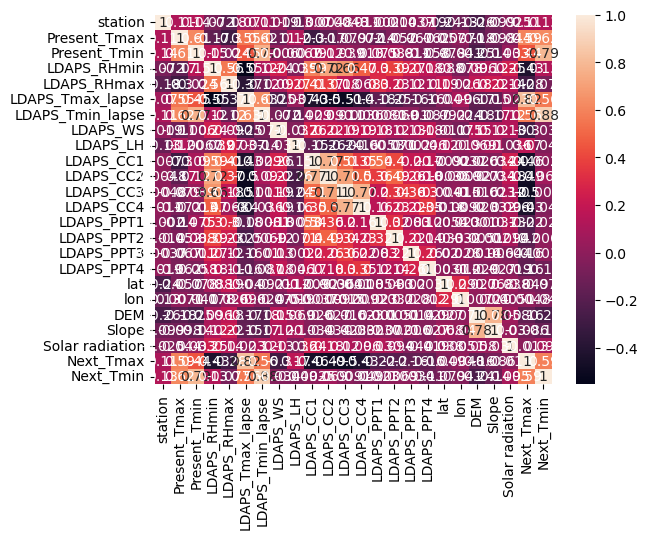

<Figure size 700x900 with 0 Axes>

In [37]:
corr_hmap = temp.corr()
sns.heatmap(corr_hmap,annot=True)
plt.figure(figsize=(7,9))

# Univariate Analysis

# Countplot

<function matplotlib.pyplot.show(close=None, block=None)>

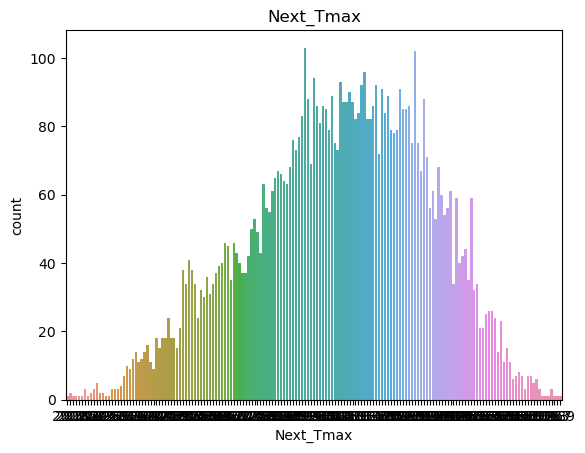

In [38]:
sns.countplot(x ='Next_Tmax', data = temp)
plt.title('Next_Tmax')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

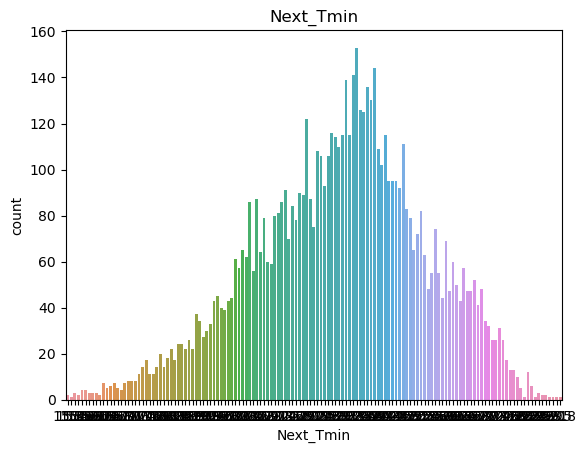

In [39]:
sns.countplot(x ='Next_Tmin', data = temp)
plt.title('Next_Tmin')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

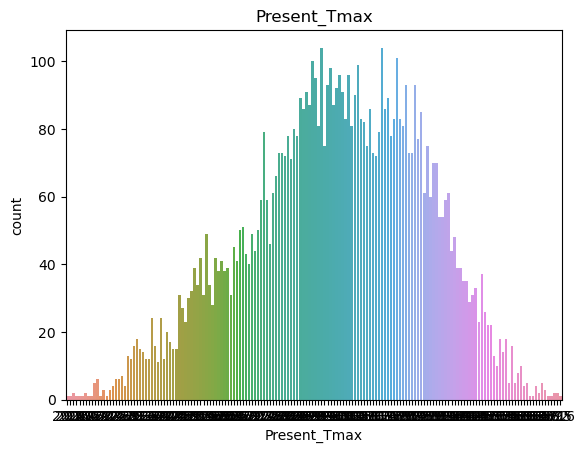

In [40]:
sns.countplot(x ='Present_Tmax', data = temp)
plt.title('Present_Tmax')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

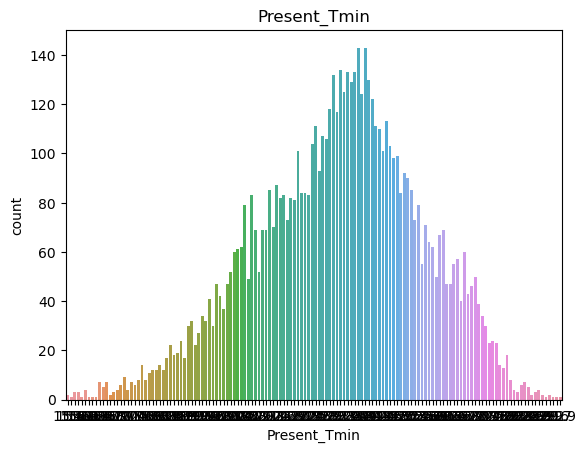

In [41]:
sns.countplot(x ='Present_Tmin', data = temp)
plt.title('Present_Tmin')
plt.show

# Distplot

<function matplotlib.pyplot.show(close=None, block=None)>

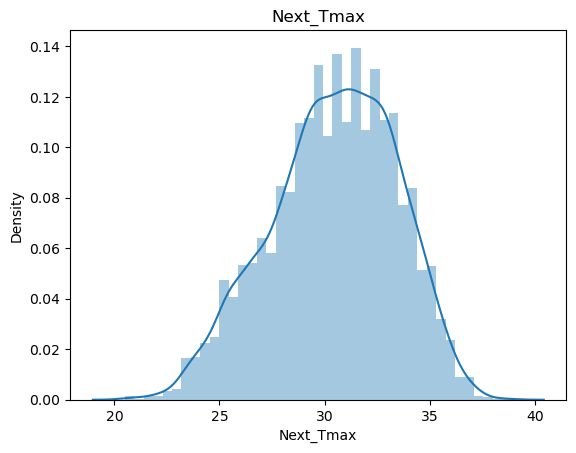

In [42]:
sns.distplot(temp['Next_Tmax'])
plt.title('Next_Tmax')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

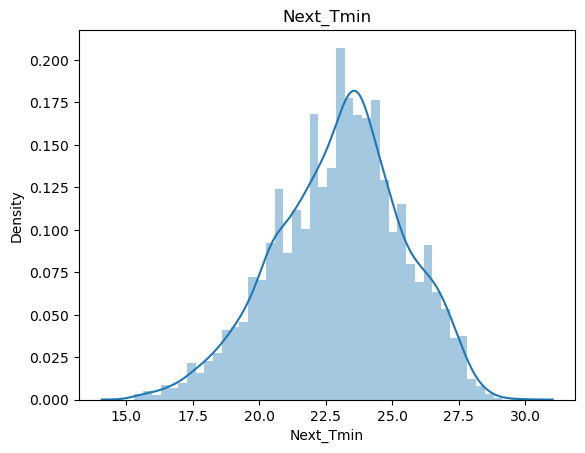

In [43]:
sns.distplot(temp['Next_Tmin'])
plt.title('Next_Tmin')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

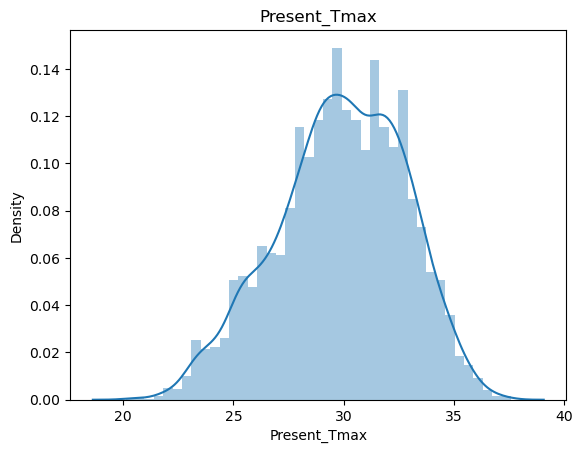

In [44]:
sns.distplot(temp['Present_Tmax'])
plt.title('Present_Tmax')
plt.show

# Lineplot

<function matplotlib.pyplot.show(close=None, block=None)>

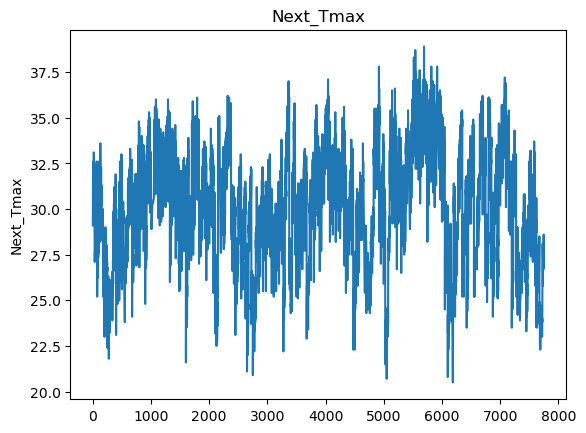

In [46]:
sns.lineplot(temp['Next_Tmax'])
plt.title('Next_Tmax')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

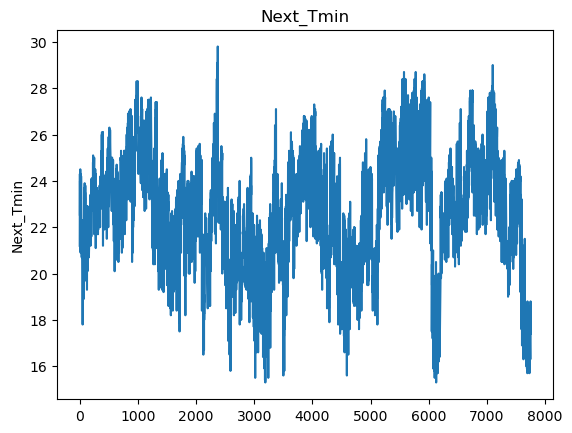

In [47]:
sns.lineplot(temp['Next_Tmin'])
plt.title('Next_Tmin')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

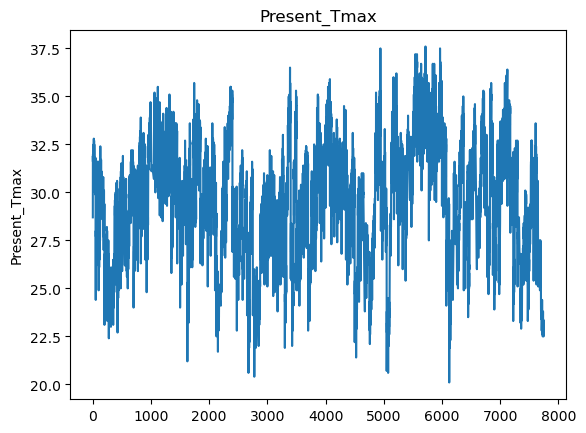

In [48]:
sns.lineplot(temp['Present_Tmax'])
plt.title('Present_Tmax')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

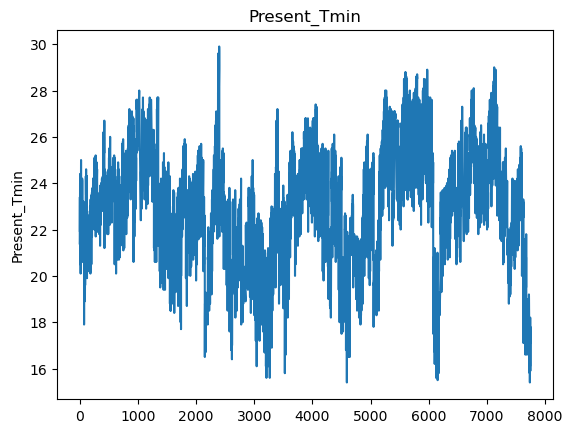

In [49]:
sns.lineplot(temp['Present_Tmin'])
plt.title('Present_Tmin')
plt.show

# KDE plot

<Axes: xlabel='Next_Tmax', ylabel='Density'>

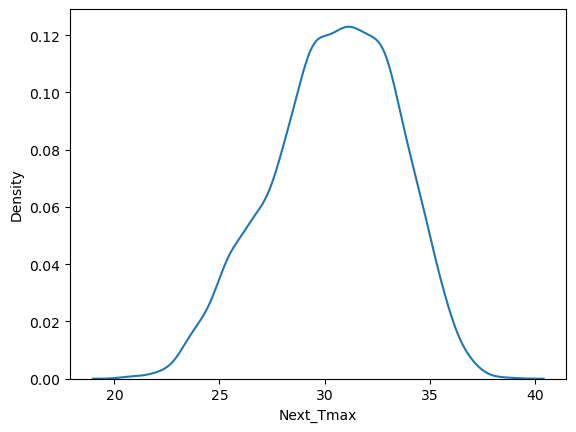

In [50]:
sns.kdeplot(data = temp.Next_Tmax)

<Axes: xlabel='Present_Tmin', ylabel='Density'>

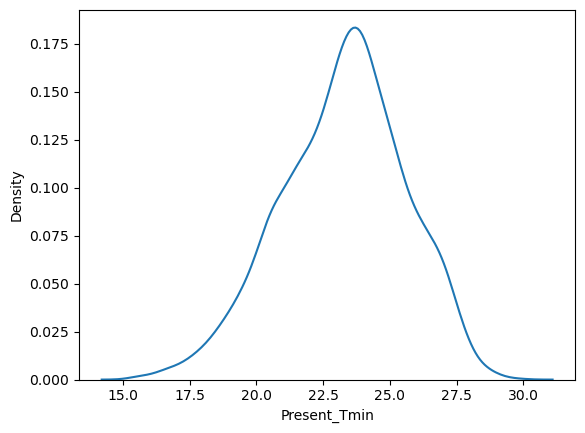

In [51]:
sns.kdeplot(data = temp.Present_Tmin)

<Axes: xlabel='Next_Tmin', ylabel='Density'>

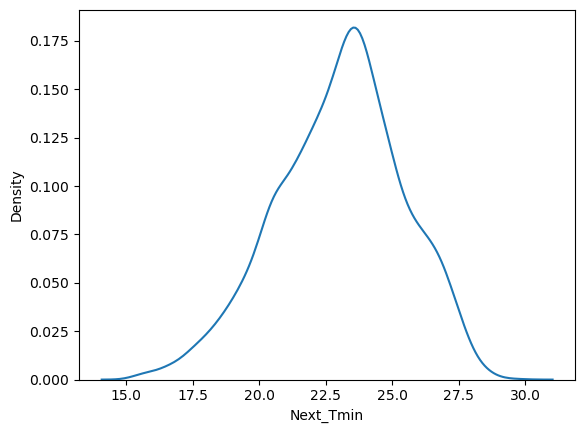

In [52]:
sns.kdeplot(data = temp.Next_Tmin)

<Axes: xlabel='Next_Tmax', ylabel='Density'>

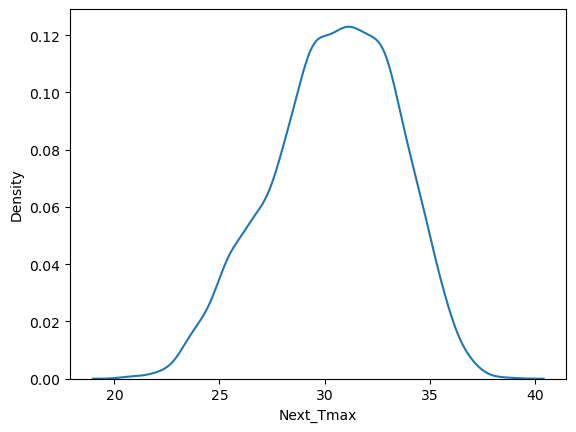

In [53]:
sns.kdeplot(data = temp.Next_Tmax)

# Bivariate Analysis

# Bar plot

<Axes: xlabel='Present_Tmax', ylabel='Next_Tmax'>

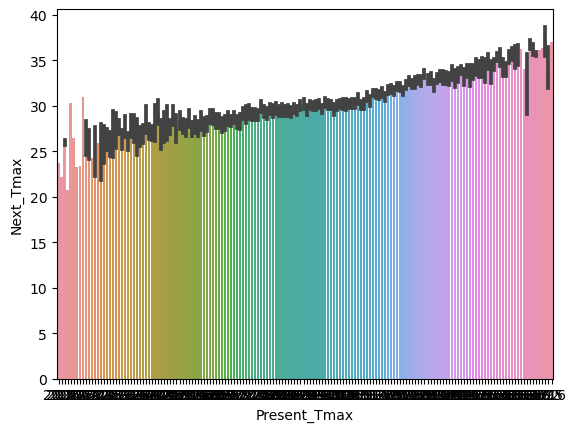

In [54]:
sns.barplot(x='Present_Tmax',y='Next_Tmax',data=temp)

<Axes: xlabel='Present_Tmin', ylabel='Next_Tmin'>

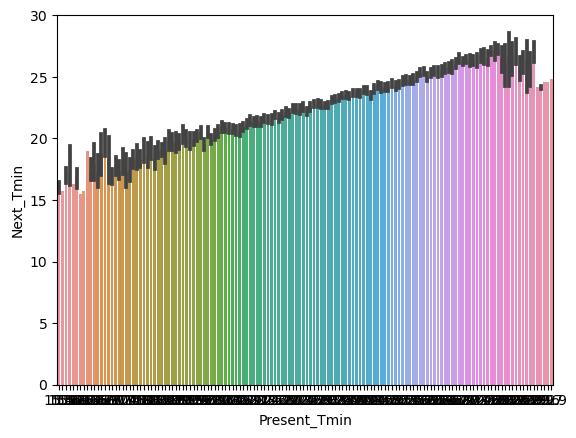

In [55]:
sns.barplot(x='Present_Tmin',y='Next_Tmin',data=temp)

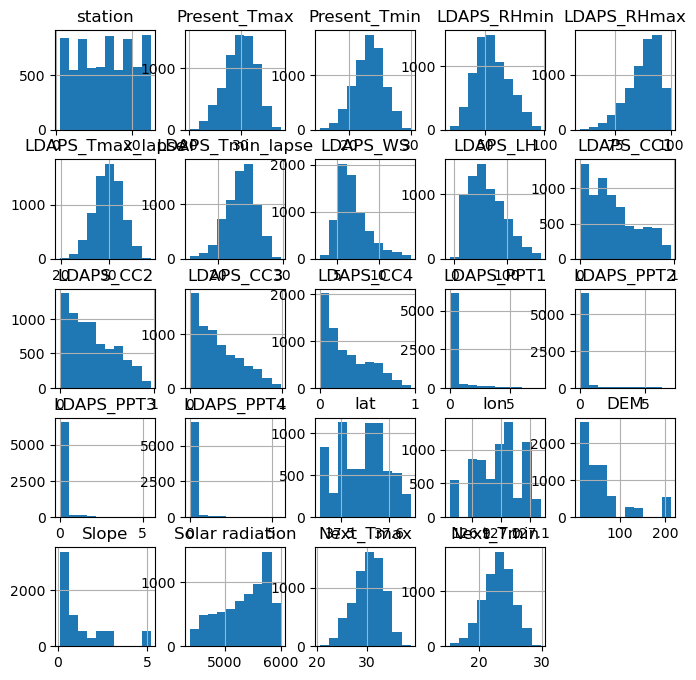

In [56]:
temp.hist(figsize=(8,8),bins=10)
plt.show()

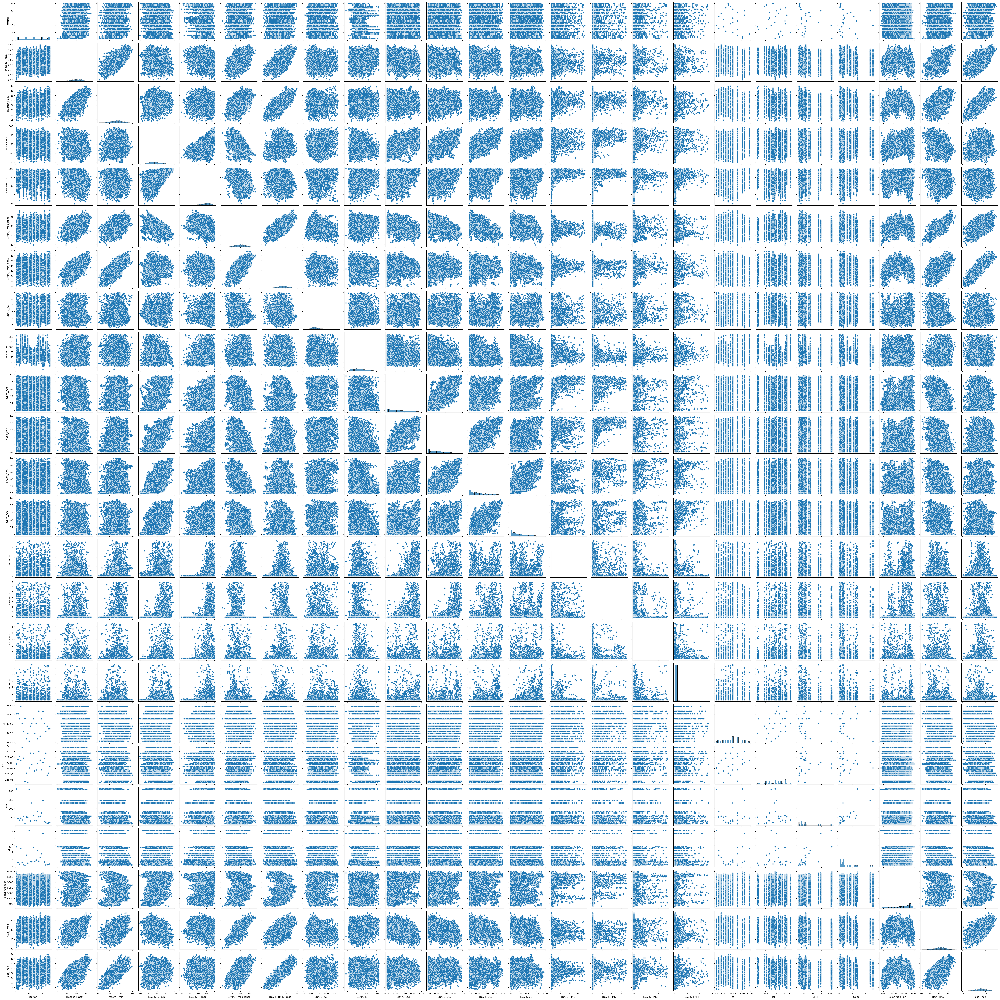

In [57]:
sns.pairplot(temp)

# Scatterplot

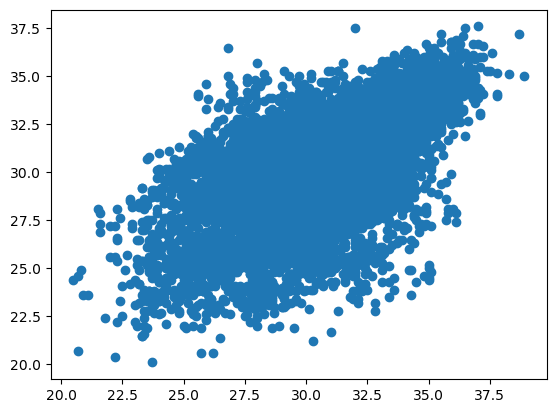

In [59]:
plt.scatter(temp['Next_Tmax'],temp['Present_Tmax'])
plt.show()

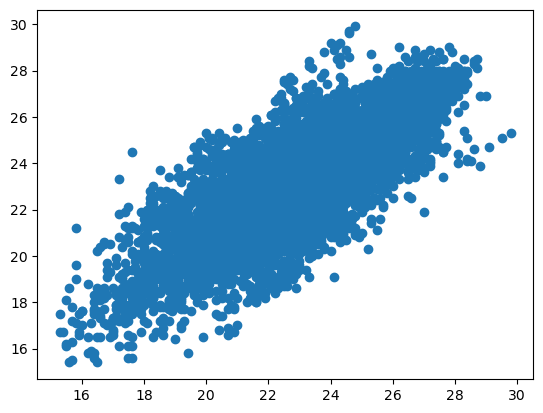

In [60]:
plt.scatter(temp['Next_Tmin'],temp['Present_Tmin'])
plt.show()

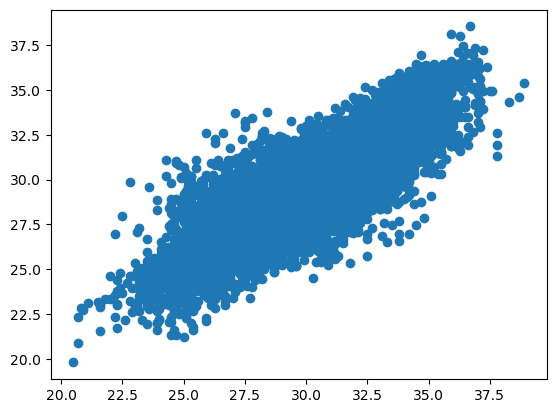

In [62]:
plt.scatter(temp['Next_Tmax'],temp['LDAPS_Tmax_lapse'])
plt.show()

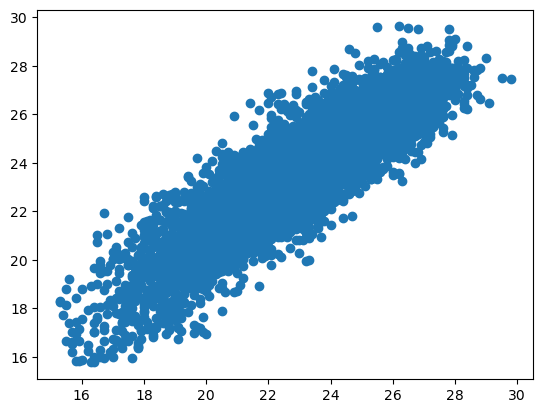

In [63]:
plt.scatter(temp['Next_Tmin'],temp['LDAPS_Tmin_lapse'])
plt.show()

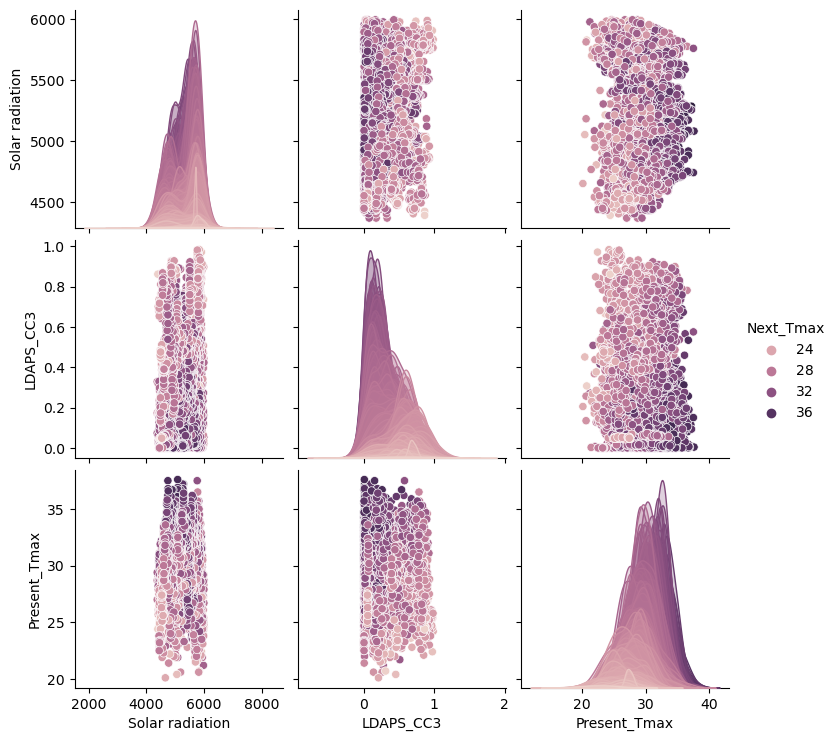

In [65]:
sns.pairplot(data=temp,hue='Next_Tmax',vars=['Solar radiation','LDAPS_CC3','Present_Tmax'])

In [64]:
temp.keys()

Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

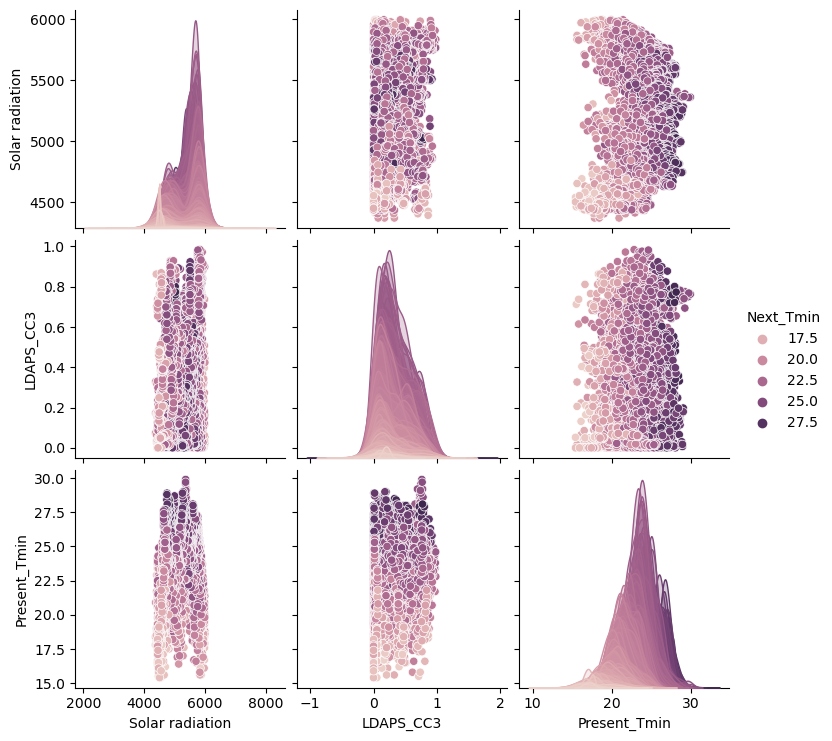

In [66]:
sns.pairplot(data=temp,hue='Next_Tmin',vars=['Solar radiation','LDAPS_CC3','Present_Tmin'])

# Joint plot

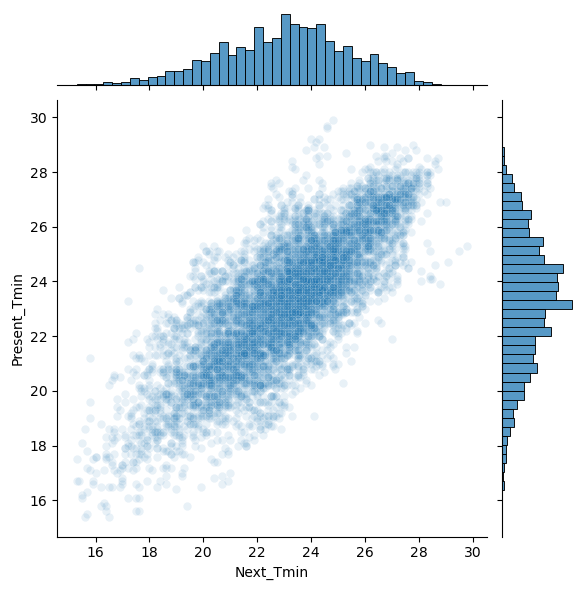

In [67]:
from scipy.stats import pearsonr
sns.jointplot(x='Next_Tmin', y='Present_Tmin', data=temp, alpha = 0.1)

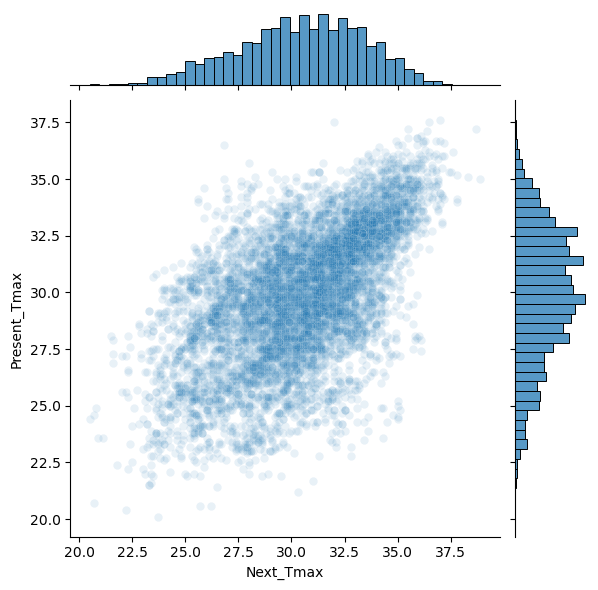

In [68]:
sns.jointplot(x='Next_Tmax', y='Present_Tmax', data=temp, alpha = 0.1)

# Training The Model

In [69]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.3,random_state=42)

In [70]:
x_train.shape

(4899, 23)

In [71]:
y_train.shape

(4899,)

In [72]:
x_test.shape

(2100, 23)

In [73]:
y_test.shape

(2100,)

# Fitting the Models for Next_Tmax

In [74]:
lm=LinearRegression()

In [75]:
lm.fit(x_train,y_train)

LinearRegression()

In [100]:
lm.score(x_train,y_train)


0.7920175166849435

In [101]:
#predict the value
pred=lm.predict(x_test)

In [102]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,pred))
print('Mean squared error:',mean_squared_error(y_test,pred))
print('Root mean squared error:',np.sqrt(mean_squared_error(y_test,pred)))

error:
Mean absolute error: 1.0824214024642576
Mean squared error: 2.0031888849159767
Root mean squared error: 1.4153405543952935


In [103]:
knn=KNeighborsRegressor()

In [104]:
knn.fit(x_train,y_train)

KNeighborsRegressor()

In [105]:
knn.score(x_train,y_train)


0.6838267997625003

In [106]:
#Predict the value
predknn=knn.predict(x_test)

In [107]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,predknn))
print('Mean squared error:',mean_squared_error(y_test,predknn))
print('Root mean squared error:',np.sqrt(mean_squared_error(y_test,predknn)))

error:
Mean absolute error: 1.6142571428571426
Mean squared error: 4.403464571428572
Root mean squared error: 2.0984433686493835


In [108]:
svm=SVR()

In [109]:
svm.fit(x_train,y_train)

SVR()

In [110]:
svm.score(x_train,y_train)


0.04454350203680457

In [111]:
predsvm=svm.predict(x_test)

In [112]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,predsvm))
print('Mean squared error:',mean_squared_error(y_test,predsvm))
print('Root mean squared error:',np.sqrt(mean_squared_error(y_test,predsvm)))

error:
Mean absolute error: 2.3870209643506506
Mean squared error: 8.733912782110211
Root mean squared error: 2.955319404414726


In [113]:
dtc=DecisionTreeRegressor()

In [114]:
dtc.fit(x_train,y_train)

DecisionTreeRegressor()

In [115]:
dtc.score(x_train,y_train)


1.0

In [116]:
preddtc=dtc.predict(x_test)

In [117]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,preddtc))
print('Mean squared error:',mean_squared_error(y_test,preddtc))
print('Root mean squared error:',np.sqrt(mean_squared_error(y_test,preddtc)))

error:
Mean absolute error: 1.056047619047619
Mean squared error: 2.1969476190476187
Root mean squared error: 1.482210382856502


In [118]:
rfc=RandomForestRegressor()

In [119]:
rfc.fit(x_train,y_train)

RandomForestRegressor()

In [120]:
rfc.score(x_train,y_train)


0.9845325806763809

In [123]:
predrfc=rfc.predict(x_test)

In [124]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,predrfc))
print('Mean squared error:',mean_squared_error(y_test,predrfc))
print('r2 score',(r2_score(y_test,predrfc)))

error:
Mean absolute error: 0.7412114285714287
Mean squared error: 0.9723252276190483
r2 score 0.8928707528919817


In [125]:
gb=GradientBoostingRegressor()

In [126]:
gb.fit(x_train,y_train)

GradientBoostingRegressor()

In [127]:
gb.score(x_train,y_train)

0.8749223489067708

In [128]:
predgb=gb.predict(x_test)

In [129]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,predgb))
print('Mean squared error:',mean_squared_error(y_test,predgb))
print('r2 score',(r2_score(y_test,predgb)))

error:
Mean absolute error: 0.9171803224262781
Mean squared error: 1.445363802481871
r2 score 0.8407521150755013


In [130]:

# Fit Lasso regression model
lasso = Lasso(alpha=0.1)
lasso.fit(x_train, y_train)

Lasso(alpha=0.1)

In [131]:
#testing the model
pred=lasso.predict(x_test)

In [132]:
lasso.score(x_train,y_train)

0.7595035117113851

In [133]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,pred))
print('Mean squared error:',mean_squared_error(y_test,pred))
print('r2 score',(r2_score(y_test,pred)))

error:
Mean absolute error: 1.1675770896683146
Mean squared error: 2.355108472724073
r2 score 0.7405178942456743


# Cross Validation score

In [134]:
#for comparing the score of different models
from sklearn.model_selection import KFold, cross_val_score
k_folds=KFold(n_splits=5)
score=cross_val_score(lm,x_train,y_train,cv=k_folds)

In [135]:
print('The Best score for Linear Model is',score.mean())

The Best score for Linear Model is 0.7892151489951967


In [136]:
score=cross_val_score(dtc,x_train,y_train,cv=k_folds)
print('The Best score Decision Tree REgressor is',score.mean())

The Best score Decision Tree REgressor is 0.7304165176996374


In [139]:
score=cross_val_score(rfc,x_train,y_train,cv=k_folds)
print('The Best score Random forest REgressor is',score.mean())

The Best score Random forest REgressor is 0.8816993606217689


In [140]:
score=cross_val_score(svm,x_train,y_train,cv=k_folds)
print('The Best score SVR is',score.mean())

The Best score SVR is 0.03247633914528503


In [141]:
score=cross_val_score(knn,x_train,y_train,cv=k_folds)
print('The Best score K Neighbour Classifier is',score.mean())

The Best score K Neighbour Classifier is 0.4954944502534803


In [142]:
score=cross_val_score(gb,x_train,y_train,cv=k_folds)
print('The Best score Gradient Boosting regressor is',score.mean())

The Best score Gradient Boosting regressor is 0.8447599653585168


In [143]:
score=cross_val_score(lasso,x_train,y_train,cv=k_folds)
print('The Best score for Lasso is',score.mean())

The Best score for Lasso is 0.7579627550302139


# Hyper Parameter Tuning the model

In [144]:
#estimating the parameters
param_grid={'n_estimators':[20,30],'max_features':['auto','sqrt'],'min_samples_split':[3,6],'min_samples_leaf':[7,9],'bootstrap':[True,False]}

In [145]:
from sklearn.model_selection import RandomizedSearchCV
rfc_random=RandomizedSearchCV(estimator=rfc,param_distributions=param_grid,n_iter=50,verbose=1,cv=5,random_state=42,n_jobs=2)

In [146]:
rfc_cv=RandomizedSearchCV(RandomForestRegressor(),param_grid,cv=5)
rfc_cv.fit(x_train,y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(),
                   param_distributions={'bootstrap': [True, False],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [7, 9],
                                        'min_samples_split': [3, 6],
                                        'n_estimators': [20, 30]})

In [147]:
print('Best Parameters',rfc_cv.best_params_)
print('Best Score',rfc_cv.best_score_)

Best Parameters {'n_estimators': 30, 'min_samples_split': 3, 'min_samples_leaf': 7, 'max_features': 'sqrt', 'bootstrap': False}
Best Score 0.874479763031973


In [148]:
r_fit=RandomForestRegressor(n_estimators= 20, min_samples_split= 3, min_samples_leaf= 7, max_features='auto', bootstrap=True)

In [149]:
r_fit.fit(x_train,y_train)

RandomForestRegressor(max_features='auto', min_samples_leaf=7,
                      min_samples_split=3, n_estimators=20)

In [150]:
df=pd.DataFrame({'Actual Data':y_test,'predicted Data':r_fit.predict(x_test)})

In [151]:
df

,Actual Data,predicted Data
7230,32.1,31.822141
3271,27.2,29.551577
2282,33.2,33.016850
332,25.9,25.809031
5024,29.9,28.793970
...,...,...
7315,25.4,25.692017
1842,30.2,30.160297
6716,32.7,34.157070
2104,25.6,25.864737


# Fitting the models for Next_Tmin

In [152]:
x=temp.drop(columns=['Next_Tmin'],axis=1)
print(x)

      station  Present_Tmax  Present_Tmin  LDAPS_RHmin  LDAPS_RHmax  \
0         1.0          28.7          21.4    58.255688    91.116364   
1         2.0          31.9          21.6    52.263397    90.604721   
2         3.0          31.6          23.3    48.690479    83.973587   
3         4.0          32.0          23.4    58.239788    96.483688   
4         5.0          31.4          21.9    56.174095    90.155128   
...       ...           ...           ...          ...          ...   
7745     21.0          23.1          17.8    24.688997    78.261383   
7746     22.0          22.5          17.4    30.094858    83.690018   
7747     23.0          23.3          17.1    26.741310    78.869858   
7748     24.0          23.3          17.7    24.040634    77.294975   
7749     25.0          23.2          17.4    22.933014    77.243744   

      LDAPS_Tmax_lapse  LDAPS_Tmin_lapse  LDAPS_WS    LDAPS_LH  LDAPS_CC1  \
0            28.074101         23.006936  6.818887   69.451805   0.233

In [153]:
y=temp['Next_Tmin']
print(y)

0       21.2
1       22.5
2       23.9
3       24.3
4       22.5
        ... 
7745    17.7
7746    17.1
7747    18.1
7748    18.8
7749    17.4
Name: Next_Tmin, Length: 6999, dtype: float64


In [154]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.3,random_state=32)

In [155]:
x_train.shape

(4899, 23)

In [156]:
 y_train.shape

(4899,)

In [157]:
x_test.shape

(2100, 23)

In [158]:
y_test.shape

(2100,)

In [159]:
lm=LinearRegression()

In [160]:
lm.fit(x_train, y_train)

LinearRegression()

In [162]:
#testing the model
pred=lm.predict(x_test)

In [163]:
lm.score(x_train,y_train)

0.8437561686768962

In [164]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,pred))
print('Mean squared error:',mean_squared_error(y_test,pred))
print('r2 score',(r2_score(y_test,pred)))

error:
Mean absolute error: 0.7518793009788215
Mean squared error: 0.907026926890063
r2 score 0.8419390144073757


In [165]:
dtc=DecisionTreeRegressor()

In [166]:
dtc.fit(x_train, y_train)

DecisionTreeRegressor()

In [167]:
dtc.score(x_train,y_train)

1.0

In [173]:
preddtc=dtc.predict(x_test)

In [174]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,preddtc))
print('Mean squared error:',mean_squared_error(y_test,preddtc))
print('r2 score',(r2_score(y_test,preddtc)))

error:
Mean absolute error: 0.8243809523809524
Mean squared error: 1.2434666666666665
r2 score 0.7833101079382501


In [175]:
rfc=RandomForestRegressor()

In [176]:
rfc.fit(x_train, y_train)

RandomForestRegressor()

In [177]:
rfc.score(x_train,y_train)

0.986283595503556

In [178]:
preddtc=dtc.predict(x_test)

In [179]:
svm=SVR()

In [180]:
svm.fit(x_train, y_train)

SVR()

In [181]:
svm.score(x_train,y_train)

0.11413663682804853

In [182]:
predsvm=svm.predict(x_test)

In [183]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,predsvm))
print('Mean squared error:',mean_squared_error(y_test,predsvm))
print('r2 score',(r2_score(y_test,predsvm)))

error:
Mean absolute error: 1.7974063234722426
Mean squared error: 5.078161647788146
r2 score 0.1150657039475671


In [186]:
knn=KNeighborsRegressor()

In [187]:
knn.fit(x_train, y_train)

KNeighborsRegressor()

In [188]:
knn.score(x_train,y_train)

0.674961809247985

In [189]:
predknn=knn.predict(x_test)

In [190]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,predknn))
print('Mean squared error:',mean_squared_error(y_test,predknn))
print('r2 score',(r2_score(y_test,predknn)))

error:
Mean absolute error: 1.3030761904761905
Mean squared error: 2.7708649523809528
r2 score 0.5171415177065881


In [191]:
gb=GradientBoostingRegressor()

In [192]:
gb.fit(x_train, y_train)

GradientBoostingRegressor()

In [193]:
gb.score(x_train,y_train)

0.9112749387775465

In [198]:
predgb=gb.predict(x_test)

In [199]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,predgb))
print('Mean squared error:',mean_squared_error(y_test,predgb))
print('r2 score',(r2_score(y_test,predgb)))

error:
Mean absolute error: 0.6314469765695865
Mean squared error: 0.6396937105610936
r2 score 0.8885252296584304


In [195]:
lasso=Lasso()

In [196]:
lasso.fit(x_train, y_train)

Lasso()

In [200]:
lasso.score(x_train,y_train)

0.787500344922405

In [202]:
pred=lasso.predict(x_test)

In [204]:
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,pred))
print('Mean squared error:',mean_squared_error(y_test,pred))
print('r2 score',(r2_score(y_test,pred)))

error:
Mean absolute error: 0.8684672101362432
Mean squared error: 1.1669433702034469
r2 score 0.796645266246333


# Cross Validation Score

In [205]:
#for comparing the score of different models
from sklearn.model_selection import KFold, cross_val_score
k_folds=KFold(n_splits=5)
score=cross_val_score(lm,x_train,y_train,cv=k_folds)

In [206]:
print('The Best score for Linear Model is',score.mean())

The Best score for Linear Model is 0.842106742291449


In [207]:

score=cross_val_score(dtc,x_train,y_train,cv=k_folds)
print('The Best score Decision Tree REgressor is',score.mean())

The Best score Decision Tree REgressor is 0.7756010775743534


In [208]:

score=cross_val_score(rfc,x_train,y_train,cv=k_folds)
print('The Best score Random Forest REgressor is',score.mean())

The Best score Random Forest REgressor is 0.8985430643391578


In [209]:

score=cross_val_score(svm,x_train,y_train,cv=k_folds)
print('The Best score SVR is',score.mean())

The Best score SVR is 0.09457031021942126


In [210]:

score=cross_val_score(gb,x_train,y_train,cv=k_folds)
print('The Best score GradientBoostingREgressor is',score.mean())

The Best score GradientBoostingREgressor is 0.8893764293358684


In [211]:

score=cross_val_score(knn,x_train,y_train,cv=k_folds)
print('The Best score K Neighbors REgressor is',score.mean())

The Best score K Neighbors REgressor is 0.4861577083727733


# Hyper parameter Tuning the Best Model

In [212]:
#estimating the parameters
param_grid={'n_estimators':[90,100],'max_features':['auto','sqrt'],'min_samples_split':[9,11],'min_samples_leaf':[20,9],'bootstrap':[True,False]}
           

In [220]:
from sklearn.model_selection import RandomizedSearchCV
rfc_random=RandomizedSearchCV(estimator=rfc,param_distributions=param_grid,n_iter=90,verbose=1,cv=5,random_state=32,n_jobs=2)

In [223]:
rfc_cv=RandomizedSearchCV(RandomForestRegressor(),param_grid,cv=5)
rfc_cv.fit(x_train,y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(),
                   param_distributions={'bootstrap': [True, False],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [20, 9],
                                        'min_samples_split': [9, 11],
                                        'n_estimators': [90, 100]})

In [224]:
print('Best Parameters',rfc_cv.best_params_)
print('Best Score',rfc_cv.best_score_)

Best Parameters {'n_estimators': 90, 'min_samples_split': 11, 'min_samples_leaf': 9, 'max_features': 'sqrt', 'bootstrap': False}
Best Score 0.8869422567396423


In [226]:
r_fit=RandomForestRegressor(n_estimators= 90, min_samples_split= 11, min_samples_leaf= 9, max_features='sqrt', bootstrap=False)

In [227]:
r_fit.fit(x_train,y_train)

RandomForestRegressor(bootstrap=False, max_features='sqrt', min_samples_leaf=9,
                      min_samples_split=11, n_estimators=90)

In [228]:
df=pd.DataFrame({'Actual Data':y_test,'predicted Data':r_fit.predict(x_test)})

In [229]:
df

,Actual Data,predicted Data
6673,25.0,24.727515
2000,21.6,20.713084
1514,21.5,22.447920
1090,23.3,24.210122
6102,18.2,18.497502
...,...,...
6397,24.5,24.412512
6015,24.6,23.723064
4631,21.7,21.091169
1062,27.6,26.009565


In [230]:
#Random Forest Regressor is the best model